# Info 

Author: Xiaoqian Sun <br>
Created: 08/2023 <br>
Function: Apply CaImAn to get F/DFF/Spikes on the TIF generated in `1.1-poissonSpikes_saveArray.ipynb`. <br>


In [1]:
import os 
import cv2
import time
import h5py
import random
import pickle
import imageio
import rasterio
import numpy as np
import pandas as pd
from tifffile import imsave
from rasterio.plot import show
import matplotlib.pyplot as plt
from scipy.ndimage import center_of_mass
from scipy.sparse import issparse, spdiags, coo_matrix, csc_matrix

from Functions import *
from simuParams import simuParams
from simulation import Simulation
from peelParams import peelParams
from peelReconstruction import peelReconstr

import caiman as cm
from caiman.motion_correction import MotionCorrect
from caiman.source_extraction.cnmf import cnmf as cnmf
from caiman.source_extraction.cnmf import params as params
from caiman.source_extraction.cnmf.utilities import detrend_df_f


try:
    cv2.setNumThreads(0)
except():
    pass


try:
    if __IPYTHON__:
        # this is used for debugging purposes only. allows to reload classes
        # when changed
        get_ipython().magic('load_ext autoreload')
        get_ipython().magic('autoreload 2')
except NameError:
    pass


import bokeh.plotting as bpl
bpl.output_notebook()


import warnings
warnings.filterwarnings('ignore')

/Users/xiaoqiansun/opt/anaconda3/envs/caiman/lib/python3.9/site-packages/oasis/functions.py:13: UserWarning: Could not find cvxpy. Don't worry, you can still use OASIS, just not the slower interior point methods we compared to in the papers.
  warn("Could not find cvxpy. Don't worry, you can still use OASIS, " +
2023-09-04 14:35:51.738524: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


Loading BokehJS ...

In [2]:
# file path
root_path = os.getcwd()
data_path = os.path.join(root_path, 'Poisson_CaImAnTest')

# parameters
dur = 10
cellNum = 10
frameRate = 30
dims = (512, 512)


# Input to CaImAn

### Parameter Obj

In [3]:
fileName = 'CaImAn'
savePath = data_path
file_path = os.path.join(data_path, 'simulation_movie.tif')
fnames = [file_path] 

In [4]:
# SETUP PARAMETERS
#===============================================================================================================
# dataset dependent parameters
fr = frameRate
decay_time = 0.6

# motion correction parameters
strides = (96, 96)    
overlaps = (48, 48)   
max_shifts = (6,6)    
max_deviation_rigid = 3
pw_rigid = True       

# parameters for source extraction and deconvolution
p = 1  
gnb = 2 
merge_thr = 0.85
rf = 15  
stride_cnmf = 6
K = 4
gSig = [8, 8] 
method_init = 'greedy_roi'
ssub = 1
tsub = 1 

# parameters for component evaluation
min_SNR = 3.0
rval_thr = 0.90
cnn_thr = 0.99 
cnn_lowest = 0.1 
opts_dict = {'fnames': fnames,'fr': fr,
            'decay_time': decay_time, 'strides': strides,
            'overlaps': overlaps, 'max_shifts': max_shifts,
            'max_deviation_rigid': max_deviation_rigid, 'pw_rigid': pw_rigid,
            'p': p, 'nb': gnb,
            'rf': rf, 'K': K, 
            'gSig': gSig, 'stride': stride_cnmf,
            'method_init': method_init, 'rolling_sum': True,
            'only_init': True, 'ssub': ssub,
            'tsub': tsub, 'merge_thr': merge_thr, 
            'min_SNR': min_SNR, 'rval_thr': rval_thr,
            'use_cnn': True, 'min_cnn_thr': cnn_thr,
            'cnn_lowest': cnn_lowest}

opts = params.CNMFParams(params_dict=opts_dict)
print('  - Done setting up parameters')


# start a cluster for parallel processing
c, dview, n_processes = cm.cluster.setup_cluster(
    backend='local', n_processes=None, single_thread=False)
print('  - Done creating cluster', n_processes)

  - Done setting up parameters
  - Done creating cluster 15


###  Step 1 - Motion Correcton

In [5]:
## Step 1 - Motion Correcton
#======================================================
# create a motion correction object with the parameters specified
startTime = time.time()

mc = MotionCorrect(fnames, **opts.get_group('motion'))
#Run piecewise-rigid motion correction
mc.motion_correct(save_movie=True)
m_els = cm.load(mc.fname_tot_els)
border_to_0 = 0 if mc.border_nan == 'copy' else mc.border_to_0 
print('  - Done motion correction, cost', round((time.time()-startTime)/60, 3), 'minutes')
startTime_in = time.time()

100%|█████████████████████████████████████████████| 1/1 [00:40<00:00, 40.84s/it]


  - Done motion correction, cost 13.863 minutes


###  Step 2 - Memory Mapping

In [6]:
## Step 2 - Memory Mapping
#======================================================
fname_new = cm.save_memmap(mc.mmap_file, base_name='memmap_', order='C',
                        border_to_0=border_to_0) # exclude borders
# load the file
Yr, dims, T = cm.load_memmap(fname_new)
images = np.reshape(Yr.T, [T] + list(dims), order='F') 
print('  - Done memory mapping, image shape=', images.shape, 
      'cost', round((time.time()-startTime)/60, 3), 'minutes')
startTime_in = time.time()

# restart cluster to clean up memory
cm.stop_server(dview=dview)
c, dview, n_processes = cm.cluster.setup_cluster(
    backend='local', n_processes=None, single_thread=False)

  - Done memory mapping, image shape= (6000, 512, 512) cost 15.349 minutes


### Step 3 - CNMF

In [7]:
## Step 3 - CNMF
#======================================================
cnm = cnmf.CNMF(n_processes, params=opts, dview=dview)
cnm = cnm.fit(images)
print('  - Done CNMF fitting , cost', round((time.time()-startTime)/60, 3), 'minutes')
startTime_in = time.time()

# get correlation image
Cn = cm.local_correlations(images.transpose(1,2,0))
Cn[np.isnan(Cn)] = 0
# save Cn for later use
np.save(os.path.join(savePath, fileName+'_localCorrImg.npy'), Cn) 
print('  - Done getting corelation img, cost', round((time.time()-startTime)/60, 3), 'minutes')
startTime_in = time.time()

2023-09-04 14:51:32.343698: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-04 14:51:32.343692: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-04 14:51:32.343700: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable th

  - Done CNMF fitting , cost 35.781 minutes
  - Done getting corelation img, cost 37.392 minutes


### Step 4 - Seeded CNMF

In [8]:
## Step 4 - Seeded CNMF
#======================================================
# RE-RUN seeded CNMF on accepted patches to refine and perform deconvolution 
cnm2 = cnm.refit(images, dview=dview)
print('  - Done re-fitting cost', round((time.time()-startTime)/60, 3), 'minutes')


startTime = time.time()
#  Component evaluation
cnm2.estimates.evaluate_components(images, cnm2.params, dview=dview)
print('  - The whole process took', round((time.time()-startTime)/60, 3), 'minutes')

  - Done re-fitting cost 38.497 minutes


/Users/xiaoqiansun/opt/anaconda3/envs/caiman/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/Users/xiaoqiansun/opt/anaconda3/envs/caiman/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


USING MODEL:/Users/xiaoqiansun/caiman_data/model/cnn_model.json


2023-09-04 15:14:30.698378: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


4/4 [==============================] - 1s 15ms/step


 30 31 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 56
 57 58 59 60 62 63 64 65 66 67 68 69 70 71 73 74 75 76 77 79 89 93 94 97
 98]. Changing their value to -1.


  - The whole process took 0.031 minutes


### Step 5 - Save F/S/C/DFF


In [9]:
## Step 5 - Select, Save and clean
#======================================================
# further select neurons with higher quality from accepted components
acceptNeurons = cnm2.estimates.idx_components


# Summary of evaluation metrics (for further pick neurons with lower noise ratio)
evaluationMetric_df = pd.DataFrame({'accpetNeurons': acceptNeurons,
                    'SNR': cnm2.estimates.SNR_comp[acceptNeurons],
                    'SpatialCoor': cnm2.estimates.r_values[acceptNeurons],
                    'cnn_preds': cnm2.estimates.cnn_preds[acceptNeurons]})  
evaluationMetric_df.to_excel(os.path.join(savePath, fileName+"-Eval.xlsx"))


### save fluorescence
f = cnm2.estimates.C[acceptNeurons, :]
F = pd.DataFrame(f.T)
F.to_csv(os.path.join(savePath, fileName+"-F.csv"))

### save spikes
s = cnm2.estimates.S[acceptNeurons, :]
S = pd.DataFrame(f.T)
S.to_csv(os.path.join(savePath, fileName+"-S.csv"))


### save dff with residual
dff_object = cnm2.estimates.detrend_df_f(quantileMin=8)
dff = dff_object.F_dff[acceptNeurons, :]  
DFF = pd.DataFrame(dff.T)
DFF.to_csv(os.path.join(savePath, fileName+"-DFF.csv"))


### calculate dff without residual
A = cnm2.estimates.A[:,acceptNeurons].toarray()
C = cnm2.estimates.C[acceptNeurons,:]
b = cnm2.estimates.b
f = cnm2.estimates.f
DDFF = pd.DataFrame(detrend_df_f(A,b,C,f, frames_window=200)).T
DDFF.to_csv(os.path.join(savePath, fileName+"-DDFF.csv")) # denoise dff


# save bad neurons' F/DFF
badNeurons = cnm2.estimates.idx_components_bad
### save F(bad)
f_b = cnm2.estimates.C[badNeurons, :]  
F_b = pd.DataFrame(f_b.T)
F_b.to_csv(os.path.join(savePath, fileName+"-FBad.csv"))
### save dff(bad)
dff_b = dff_object.F_dff[badNeurons, :]  
DFF_b = pd.DataFrame(dff_b.T)
DFF_b.to_csv(os.path.join(savePath, fileName+"-DFFBad.csv"))
### save denoisedDFF
A_b = cnm2.estimates.A[:,badNeurons].toarray()
C_b = cnm2.estimates.C[badNeurons,:]
DDFF_b = pd.DataFrame(detrend_df_f(A_b,b,C_b,f, frames_window=200)).T
DDFF_b.to_csv(os.path.join(savePath, fileName+"-DDFFBad.csv")) # denoise dff


print('Done with DFF, Fluorescence, Spikes with shapes:', DFF.shape, F.shape, S.shape)

Done with DFF, Fluorescence, Spikes with shapes: (6000, 7) (6000, 7) (6000, 7)


In [10]:
# picked neurons in 1.1
pickedNeurons = pd.read_csv(os.path.join(data_path, 'pickedNeurons.csv')).iloc[:, 2:]

# coordinates
coorXs = []
coorYs = []
pairNs = []
pairDis = []
for i in range(len(acceptNeurons)): 
    image = A[:,i].reshape(dims[1], dims[0])
    x,y = center_of_mass(image)
    coorXs.append(y) # the image was upside-down
    coorYs.append(x)
    
    minDis=np.inf
    pairN = 0
    for m in range(len(pickedNeurons)):
        dis = np.sqrt( (pickedNeurons.iloc[m]['x']-y)**2 + (pickedNeurons.iloc[m]['y']-x)**2)
        if dis < minDis:
            minDis = dis
            pairN = m
    pairNs.append(pairN)
    pairDis.append(minDis)

C = pd.DataFrame({'CaImAnX':coorXs, 'CaImAnY':coorYs, 'pairWith':pairNs, 'Distance':pairDis})



C_P = pd.concat([pickedNeurons, C], axis=1)
C_P.to_excel(os.path.join(savePath, fileName+"-C.xlsx"))

print('Done saving coordinates with shape:', C.shape)

Done saving coordinates with shape: (7, 4)


### Step 6 - Some Plots

In [11]:
# plot all neurons
plot_neuronTrace_DFs([F],['Fluorescence'],['b'],[1],[1],
                     ifSave=True,savePath=data_path,filename='CaImAn_F' )
plot_neuronTrace_DFs([S],['Spikes'],['b'],[1],[1],
                     ifSave=True,savePath=data_path,filename='CaImAn_S' )
plot_neuronTrace_DFs([DFF],[ 'DFF'],['b'],[1],[1],
                     ifSave=True,savePath=data_path,filename='CaImAn_DFF' )
plot_neuronTrace_DFs([DDFF],[ 'DDFF'],['b'],[1],[1],
                     ifSave=True,savePath=data_path,filename='CaImAn_DDFF' )


In [12]:
cnm2.estimates.plot_contours_nb(img=Cn, idx=cnm2.estimates.idx_components)

In [13]:
# plot further selected neurons contours
cnm2.estimates.nb_view_components(img=Cn, idx=np.array(acceptNeurons), denoised_color='red')

In [19]:
# plot further selected neurons contours
cnm2.estimates.nb_view_components(img=Cn, idx=cnm2.estimates.idx_components_bad, denoised_color='red')

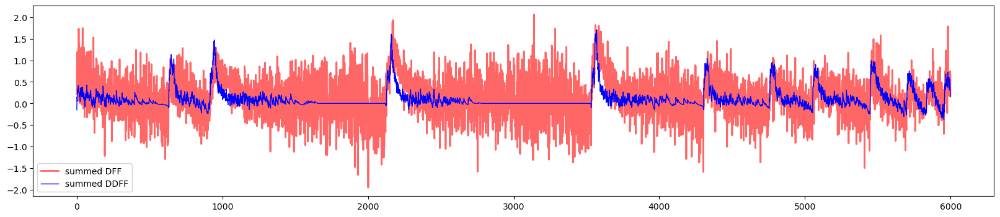

In [58]:
# Add up a segmented neuron signal & plot 

# top right neuron
# 77(76)，81(80)， 82(81)， 89(88) 
label1 ='summed DFF'
summedNeuronActivity_dff = DFF_b.iloc[:, 76] + DFF_b.iloc[:, 80] + DFF_b.iloc[:, 81] + DFF_b.iloc[:, 88]
# summedNeuronActivity = DFF_b.iloc[:, 76] + DFF_b.iloc[:, 88]

label2 ='summed Fluorescence'
summedNeuronActivity_f = F_b.iloc[:, 76] + F_b.iloc[:, 80] + F_b.iloc[:, 81] + F_b.iloc[:, 88]
# summedNeuronActivity = F_b.iloc[:, 76] + F_b.iloc[:, 88]

label3 ='summed DDFF'
summedNeuronActivity_ddff = DDFF_b.iloc[:, 76] + DDFF_b.iloc[:, 80] + DDFF_b.iloc[:, 81] + DDFF_b.iloc[:, 88]
# summedNeuronActivity = DDFF_b.iloc[:, 76] + DDFF_b.iloc[:, 88]

# plot
plt.figure(figsize=(20, 4))
plt.plot(summedNeuronActivity_dff, c='r', alpha=0.6, lw=2, label=label1)
plt.plot(summedNeuronActivity_ddff, c='b', alpha=1, lw=1, label=label3)


plt.legend(loc='best')
plt.show()

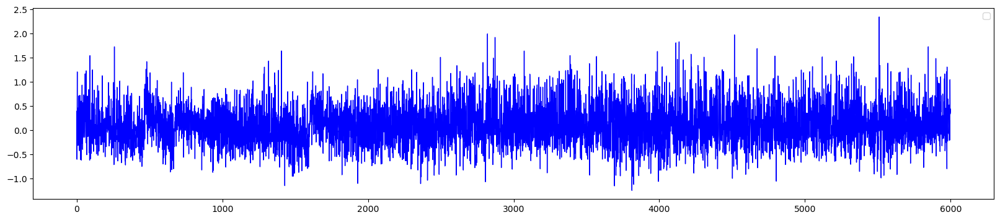

In [67]:
# Add up a segmented neuron signal & plot 

# top right neuron in correlation img
# 3(2)，4(3)， 7(6)
label1 ='summed DFF'
# summedNeuronActivity_dff = DFF.iloc[:, 2] + DFF.iloc[:, 3] + DFF.iloc[:, 6]
summedNeuronActivity_dff = DFF.iloc[:, 2] #+ DFF.iloc[:, 3]

label2 ='summed Fluorescence'
summedNeuronActivity_f = F.iloc[:, 2] + F.iloc[:, 3] + F.iloc[:, 6] 
# summedNeuronActivity = F.iloc[:, 2] + F.iloc[:, 3]

# label3 ='summed DDFF'
summedNeuronActivity_ddff = DDFF.iloc[:, 2] + DDFF.iloc[:, 3] + DDFF.iloc[:, 6] 
# summedNeuronActivity = DDFF.iloc[:, 2] + DDFF.iloc[:, 3]

# plot
plt.figure(figsize=(20, 4))
# plt.plot(summedNeuronActivity_dff, c='r', alpha=0.6, lw=2, label=label1)
plt.plot(summedNeuronActivity_dff, c='b', alpha=1, lw=1, label=label1)
# plt.plot(summedNeuronActivity_f, c='b', alpha=1, lw=1, label=label2)


plt.legend(loc='best')
plt.show()

IndexError: list index out of range

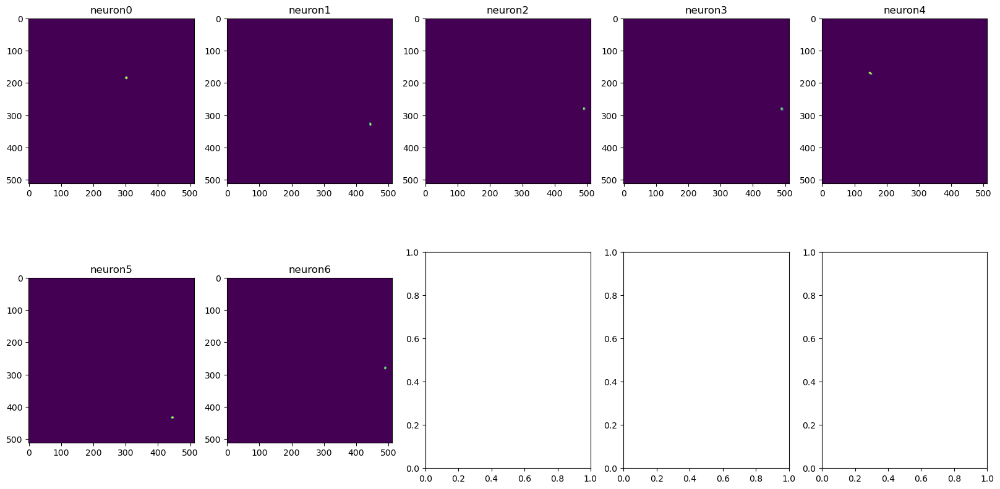

In [21]:
plot_selectNeuronShape(A,list(range(A.shape[1])),rows=2,cols=5,figsize=(20, 10),
                       ifTranspose=True,ifSave=True,savePath=data_path,filename='caImAnNeuronShape')

In [ ]:
# STOP CLUSTER
cm.stop_server(dview=dview)